In [2]:
import os
#Pour la carte
import matplotlib.pyplot as plt
import geopandas as gpd
import subPart1_2 as s #notre module

In [3]:
#On récupère les données nécessaires 
listings= s.listings

<AxesSubplot:>

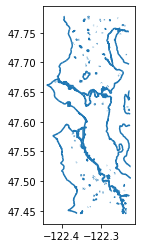

In [5]:
#affichage de la carte de Seattle
path=os.getcwd()
street_map1 = gpd.read_file(path+'/City_of_Seattle_Shoreline.geojson')
street_map1.plot()

In [6]:
#création d'une nouvelle variable geometry qui a pour but d'utiliser la longitude et la latitude pour former des coordonnées de points.
geo_listings = gpd.GeoDataFrame(listings, geometry = gpd.points_from_xy(listings['longitude'], listings['latitude']))
geo_listings.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,geometry
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,...,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07,POINT (-122.37103 47.63629)
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",...,f,NaN,WASHINGTON,f,strict,t,t,6,1.48,POINT (-122.36567 47.63912)
2,3308979,https://www.airbnb.com/rooms/3308979,20160104002432,2016-01-04,New Modern House-Amazing water view,New modern house built in 2013. Spectacular s...,"Our house is modern, light and fresh with a wa...",New modern house built in 2013. Spectacular s...,none,Upper Queen Anne is a charming neighborhood fu...,...,f,NaN,WASHINGTON,f,strict,f,f,2,1.15,POINT (-122.36948 47.62972)
3,7421966,https://www.airbnb.com/rooms/7421966,20160104002432,2016-01-04,Queen Anne Chateau,A charming apartment that sits atop Queen Anne...,NaN,A charming apartment that sits atop Queen Anne...,none,NaN,...,f,NaN,WASHINGTON,f,flexible,f,f,1,NaN,POINT (-122.36928 47.63847)
4,278830,https://www.airbnb.com/rooms/278830,20160104002432,2016-01-04,Charming craftsman 3 bdm house,Cozy family craftman house in beautiful neighb...,Cozy family craftman house in beautiful neighb...,Cozy family craftman house in beautiful neighb...,none,We are in the beautiful neighborhood of Queen ...,...,f,NaN,WASHINGTON,f,strict,f,f,1,0.89,POINT (-122.37247 47.63292)


<AxesSubplot:>

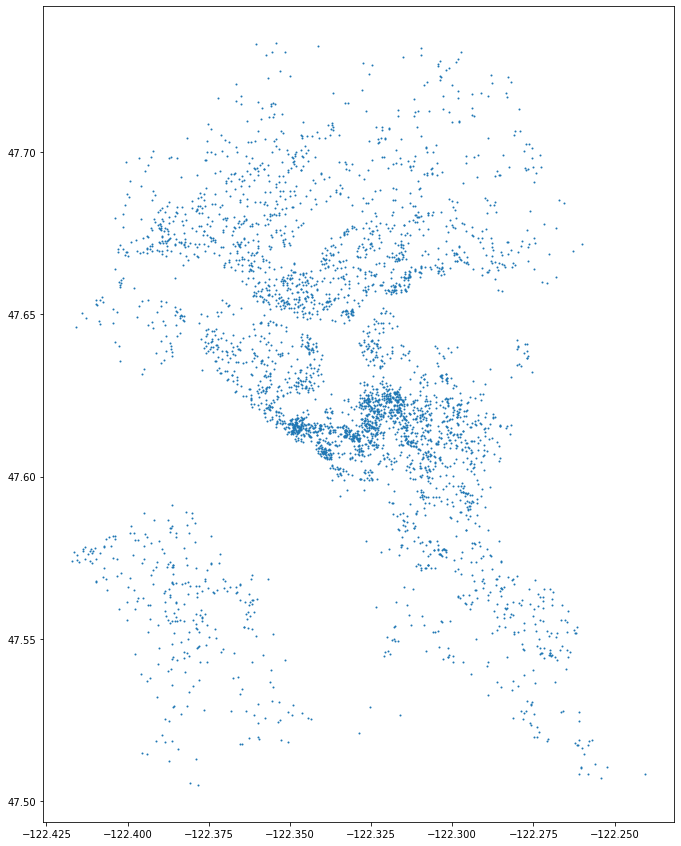

In [7]:
#afficher les points de localisation
fig, ax = plt.subplots(figsize = (15,15))
geo_listings.plot(ax = ax, markersize=1)

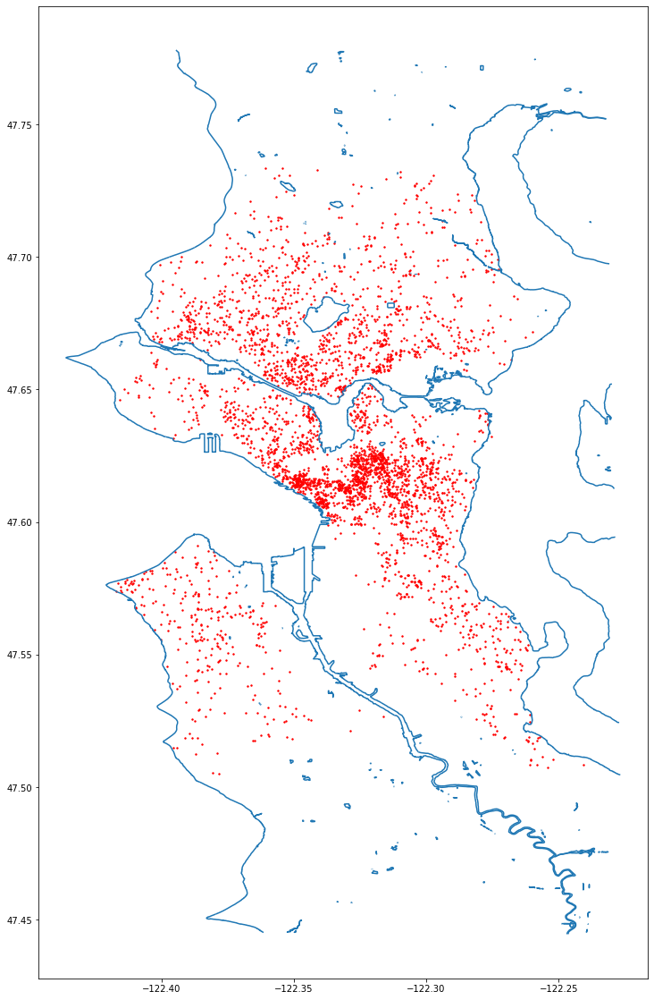

In [8]:
#creation de notre carte avec les points de coordonnées (combinaison des deux précedentes cartes)
fig, ax = plt.subplots(figsize = (20,20))
street_map1.plot(ax = ax)
geo_listings.plot(ax = ax, markersize=2, color='red')


plt.show()

In [9]:
#Pour embellir notre carte nous avons différencié les points selon le type de logement
listings_appart=listings.loc[listings["property_type"]=="Apartment"]
listings_loft=listings.loc[listings["property_type"]=="Loft"]
listings_house=listings.loc[listings["property_type"]=="House"]
listings_townhouse=listings.loc[listings["property_type"]=="Townhouse"]
listings_condominium=listings.loc[listings["property_type"]=="Condominium"]
listings_boat=listings.loc[listings["property_type"]=="Boat"]
geo_listings_appart=gpd.GeoDataFrame(listings_appart,geometry=gpd.points_from_xy(listings_appart['longitude'], listings_appart['latitude']))
geo_listings_loft=gpd.GeoDataFrame(listings_loft,geometry=gpd.points_from_xy(listings_loft['longitude'], listings_loft['latitude']))
geo_listings_house=gpd.GeoDataFrame(listings_house,geometry=gpd.points_from_xy(listings_house['longitude'], listings_house['latitude']))
geo_listings_townhouse=gpd.GeoDataFrame(listings_townhouse,geometry=gpd.points_from_xy(listings_townhouse['longitude'], listings_townhouse['latitude']))
geo_listings_condominium=gpd.GeoDataFrame(listings_condominium,geometry=gpd.points_from_xy(listings_condominium['longitude'], listings_condominium['latitude']))
geo_listings_boat=gpd.GeoDataFrame(listings_boat,geometry=gpd.points_from_xy(listings_boat['longitude'], listings_boat['latitude']))


<AxesSubplot:>

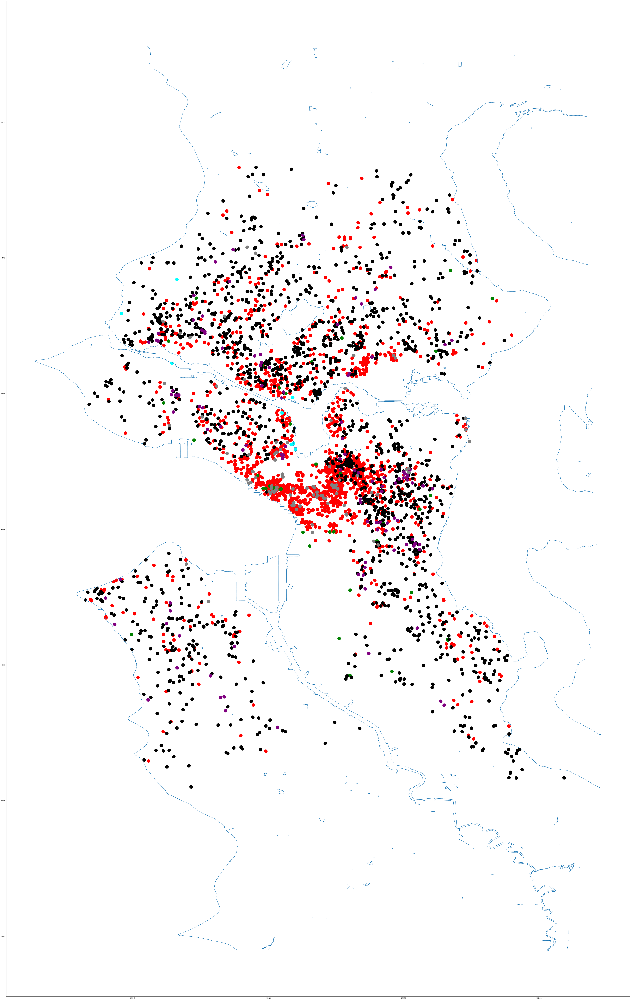

In [10]:
fig, ax = plt.subplots(figsize = (125,125))
street_map1.plot(ax = ax)
geo_listings_appart.plot(ax = ax, markersize=500, color='red')
geo_listings_loft.plot(ax = ax,markersize=500, color='green')
geo_listings_house.plot(ax=ax, markersize=500,color="black")
geo_listings_townhouse.plot(ax=ax, markersize=500,color="purple")
geo_listings_condominium.plot(ax=ax, markersize=500,color="grey")
geo_listings_boat.plot(ax=ax, markersize=500,color="cyan")

On peut voir qu'il y a majoritairement des appartements et des maisons.

### Pour aller plus loin : carte interactive

In [11]:
#Geopandas permet d'afficher une carte interactive grâce à explore()
#
gpd.GeoDataFrame(listings,
                 crs = {'init': 'epsg:4326'},#le crs(coordonnées de référence du système) permet d'obtenir le fond de carte sans lui il y aurait que les points.
                 geometry = gpd.points_from_xy(listings['longitude'], listings['latitude'])).explore(column='property_type',#permet de différencier par couleurs les types de logements
                                                                                                     tooltip={"name","property_type","latitude","longitude","id","host_name","neighbourhood_cleansed","price"},#selection des informations qui seront affichés par les points
                                                                                                     style_kwds=dict(color="black",opacity=0.2,fillOpacity=0.9),#options pour préciser le contour des points et de l'opacité des couleurs (sinon les points sont trop transparents.)
                                                                                                     marker_kwds=dict(radius=5))#précision sur la taille des points sinon c'est trop petit par défaut. 

C:\ProgramData\Anaconda3\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
